In [1]:
import pandas as pd
import warnings
warnings.filterwarnings('ignore')
import geopandas as gpd
import geoplot
import geoplot.crs as gcrs
import matplotlib.pyplot as plt
import math
import seaborn as sns
import plotly.express as px
import numpy as np
#from tslearn.clustering import TimeSeriesKMeans
from plotly.subplots import make_subplots
from scipy import stats

# Importo dataset utili

In [2]:
# dataset con i dati di rilevamento
rilevazioni = pd.read_csv("merged_datas.csv")
# modifica del campo Data: da object a datetime
rilevazioni['Data'] = rilevazioni.Data.apply(pd.to_datetime)

# anagrafica stazioni
anagrafica_centraline = pd.read_csv("aq_labservice_anagrafica_stazioni.csv")

anagrafica_centraline = anagrafica_centraline[['denominazione', 'indirizzo','latitudine', 'longitudine']]
anagrafica_centraline['denominazione'] = anagrafica_centraline.denominazione.str.upper()
anagrafica_centraline.rename(columns = {'denominazione': 'Location'}, inplace = True)
anagrafica_centraline['Location'] = anagrafica_centraline.Location.str.replace(" ", "")
anagrafica_centraline.loc[anagrafica_centraline.Location.str.contains("COCOMARO"), "Location"] = "COCOMARO"

In [3]:
rilevazioni.head()

,Data,Day_of_Week,Location,Month_Name,O3,Pr,RH,T,VOC
0,2022-05-31 22:00:00,Tuesday,ARGINONE,May,26.1,1013.9,75.0,22.5,82.4213
1,2022-05-31 23:00:00,Tuesday,ARGINONE,May,21.9,1013.8,78.0,21.6,82.6649
2,2022-06-01 00:00:00,Wednesday,ARGINONE,June,22.1,1013.7,80.6,21.2,83.0016
3,2022-06-01 01:00:00,Wednesday,ARGINONE,June,20.7,1013.9,82.0,21.2,82.7855
4,2022-06-01 02:00:00,Wednesday,ARGINONE,June,20.1,1014.1,82.9,21.2,82.8018


In [4]:
anagrafica_centraline.head()

,Location,indirizzo,latitudine,longitudine
0,BARCO,"Via Rino Maragno 46, Ferrara",44.860988,11.607838
1,MODENA,"Via Guglielmo Marconi 19, Ferrara",44.846107,11.598717
2,PORTACATENA,"Piazzale dei Giochi 67, Ferrara",44.848840,11.612900
3,ARGINONE,"Via Arginone 206 B, Ferrara",44.842270,11.583010
4,CORSOISONZO,"Corso Isonzo 1, Ferrara",44.841510,11.612110


In [5]:
# colonne inquinanti
inquinanti = {
    "O3": "ozono",
    "Pr": "pressione",
    "RH": "umidità relativa",
    "T": "temperatura",
    "VOC": "volatile organic compounds"
}
for c in inquinanti.keys():
    title = c + ": " + inquinanti[c]
    fig = px.line(rilevazioni, x ="Data", y=c, color = "Location", title = title)
    
    
    fig.show()

In [6]:
df_ARGINONE = rilevazioni.loc[np.where(rilevazioni["Location"]=="ARGINONE")]

In [88]:
def single_figure_plot (data , n , font_scale , x_size , y_size):
    fig, ax = plt.subplots(n-1 , n , figsize=(x_size, y_size), sharey=True)
    sns.set(font_scale=font_scale)
    k = 0
    for i in range(data.shape[1]):
        k = k + 1
        for j in range(data.shape[1]): 
            if j+k < data.columns.shape[0]:
                print("x : {}   y : {}".format(data.columns[i],data.columns[j+k]))
                ax[i,j+k].set_ylabel(data.columns[j+k])
                ax[i,j+k].set_ylim(top=max(data[data.columns[j+k]])+max(data[data.columns[j+k]])*0.1)
                ax[i,j+k].tick_params(axis="y" , labelleft=True )
                ax[i,j+k].set_title(data.columns[i]+" - "+data.columns[j+k])
                sp = sns.scatterplot(x=data.columns[i], 
                                     y = data.columns[j+k] , 
                                     data = data,
                                     ax=ax[i,j+k])

    plt.show()        

 
                jp = sns.jointplot(ax=ax , x=data.columns[i], y = data.columns[i+1], kind='reg', data = data)
                r, p = stats.pearsonr(data[data.columns[i]], data[data.columns[i+1]])
                phantom, = jp.ax_joint.plot([], [], linestyle="", alpha=0)
                jp.ax_joint.legend([phantom],['r={:f}, p={:f}'.format(r,p)])
             
                


x : O3   y : Pr
x : O3   y : RH
x : O3   y : T
x : O3   y : VOC
x : Pr   y : RH
x : Pr   y : T
x : Pr   y : VOC
x : RH   y : T
x : RH   y : VOC
x : T   y : VOC


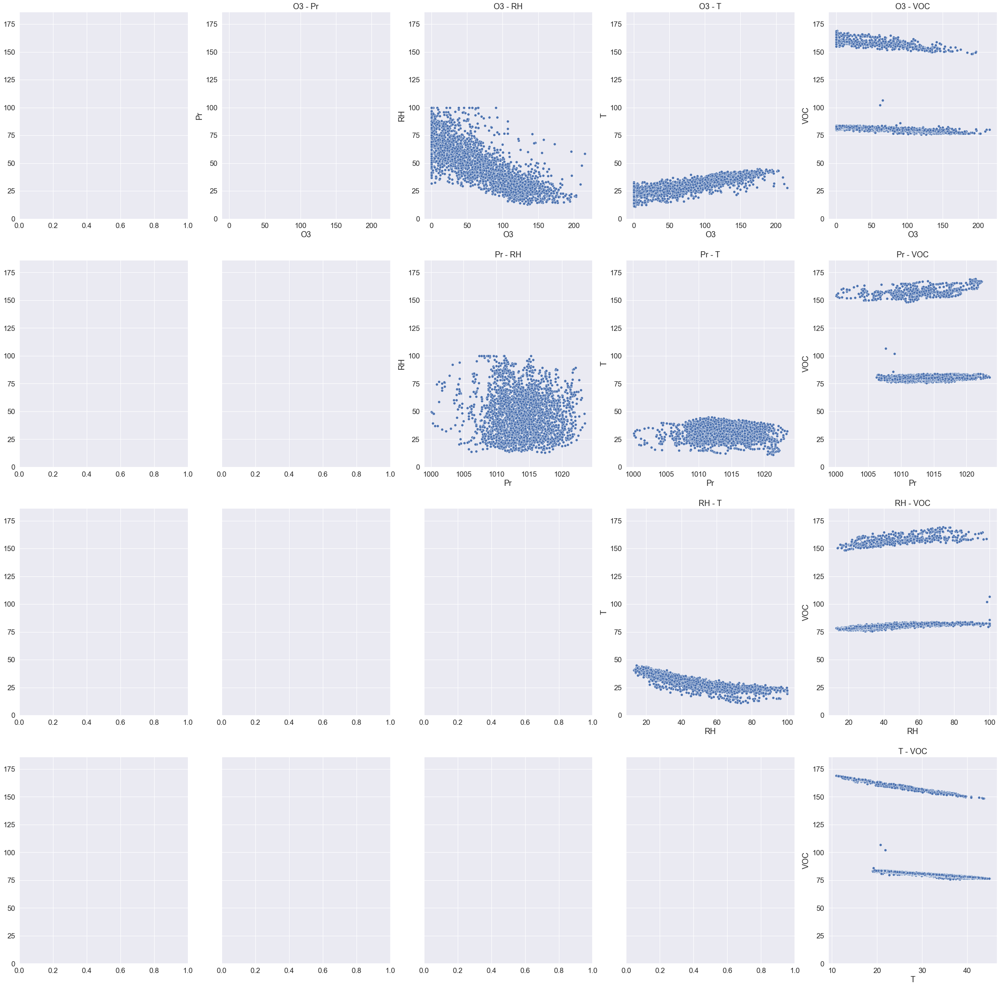

In [89]:
single_figure_plot( data = df_ARGINONE[inquinanti.keys()] ,
                    n  = 5 , 
                    font_scale = 1.5 , 
                    x_size = 40, 
                    y_size = 40)

# Analisi correlazioni tra inquinanti

<AxesSubplot:>

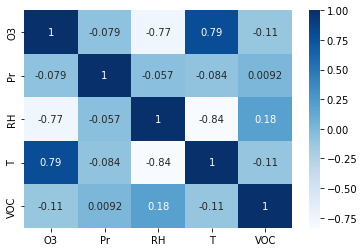

In [5]:
cmap=sns.diverging_palette(5, 250, as_cmap=True)

corr = rilevazioni[inquinanti.keys()].corr()

sns.heatmap(corr, cmap="Blues", annot=True)

In [6]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "T", title="Correlation O3 - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

In [7]:
fig = px.scatter(data_frame=rilevazioni, x = "O3", y = "RH", title="Correlation O3 - RH", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

In [8]:
fig = px.scatter(data_frame=rilevazioni, x = "RH", y = "T", title="Correlation RH - T", trendline = "ols", trendline_scope="overall")
fig.update_traces(marker=dict(size=2,
                              line=dict(width=2,
                                        color='blue')), opacity = 0.5,
                  selector=dict(mode='markers'))

## Trend analys with rolling

In [9]:
def get_rolling_mean(df,location_col,location_param,col,num,center): 
    df_rolling = df.copy() 
    df_rolling = df_rolling.loc[df_rolling[location_col] == location_param].copy() 
    for cols in col: 
        df_rolling[f"Rolling_{cols}"] = df_rolling[cols].rolling(int(num),center=center).mean() 
    return df_rolling

In [10]:
#fig = px.scatter_3d(rolling_df, x ="Rolling_Pr", y="Rolling_O3", z="Rolling_RH", color = "Location", animation_frame="Month_Name")
rolling_df = pd.DataFrame()
for centralina in list(rilevazioni.Location.unique()):
    prova = get_rolling_mean(rilevazioni, "Location", centralina, ["O3", "Pr", "RH", "T", "VOC"],48,False)
    rolling_df = rolling_df.append(prova)
rolling_df = rolling_df.sort_values(by='Data', ascending = False)
for c in rolling_df:
    if 'Rolling' in c:
        title = c.split("_",1)[1]
        fig = px.line(rolling_df, x ="Data", y=c, color = "Location", title = title)
        fig.show()

## Analisys with Map

In [11]:
# geopandas json
data = gpd.read_file("limits_IT_municipalities.geojson")
data = data[data.name == 'Ferrara']

crs={'init':'epsg:4326'}
# creazione dataframe geo partendo da dataframe stazioni
geo_df=gpd.GeoDataFrame(anagrafica_centraline,crs=crs,geometry=gpd.points_from_xy(anagrafica_centraline["longitudine"], anagrafica_centraline["latitudine"]))

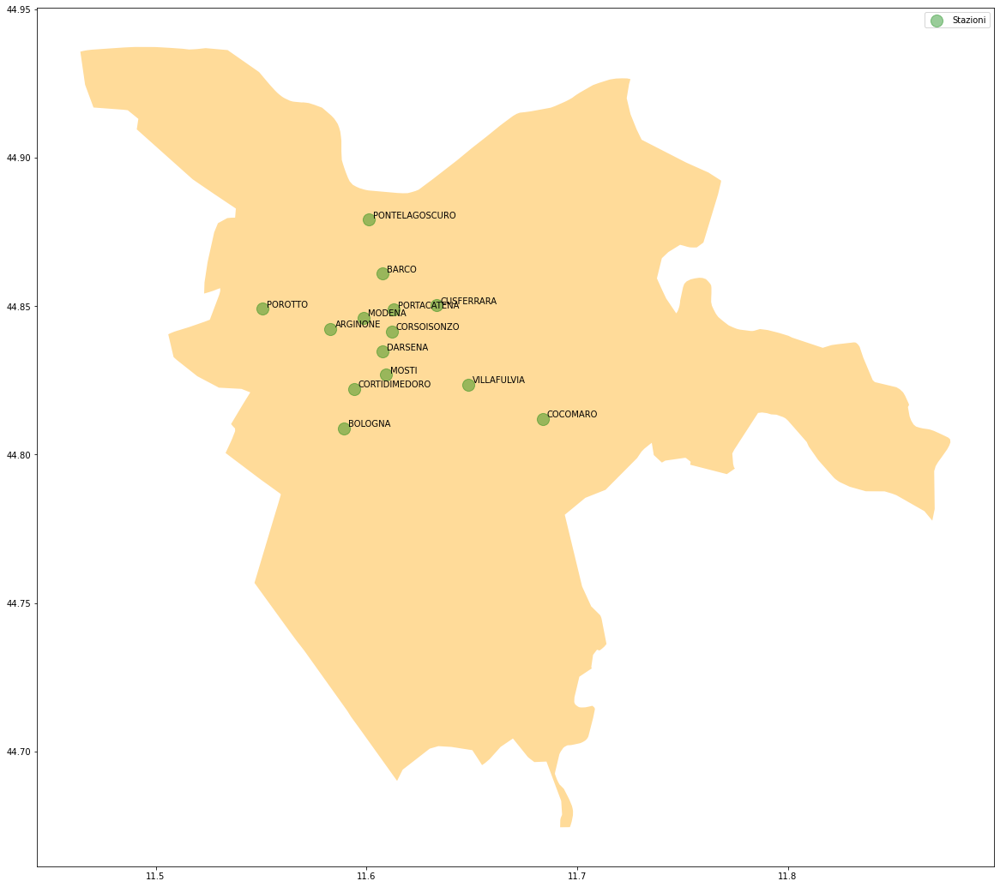

In [12]:
fig, ax = plt.subplots(figsize = (20,20))
data.plot(ax = ax, alpha = 0.4, color = "orange")
geo_df.plot(ax=ax,markersize=200, alpha=0.4,color="green", label = "Stazioni")
for x, y, label in zip(geo_df.longitudine, geo_df.latitudine, geo_df.Location):
    ax.annotate(label, xy=(x, y), xytext=(5, 5), textcoords="offset points", va = "center")
plt.legend()
plt.show()

In [13]:
import geoplot
import geoplot.crs as gcrs

In [14]:
rilevazioni_copy = rilevazioni.copy()
def std(x): 
    return np.std(x)
df_stddev = rilevazioni_copy.groupby("Location").agg([std])[['O3', 'Pr', 'T', 'VOC', 'RH']].reset_index()
df_stddev = df_stddev.droplevel(1, axis = 1)
df_stddev

,Location,O3,Pr,T,VOC,RH
0,ARGINONE,50.012123,3.725538,6.158405,31.606725,19.514486
1,BARCO,54.620721,3.753086,6.166282,44.704531,18.751985
2,BOLOGNA,45.993734,3.744462,5.897936,24.421701,17.291302
3,COCOMARO,47.855642,3.750624,5.837015,120.929677,17.811632
4,CORSOISONZO,47.362499,3.739267,5.070438,108.772447,17.311625
5,CUSFERRARA,57.183544,3.764254,6.680610,36.671022,20.284407
6,MODENA,41.326824,3.731096,5.933930,151.933861,16.930992
7,MOSTI,42.603470,3.731964,5.891939,109.633057,15.524533
8,PONTELAGOSCURO,51.377294,3.724658,6.208419,44.691248,17.987143
9,POROTTO,50.025880,3.711162,5.453408,447.399862,14.917105


In [15]:
geo_df = pd.merge(geo_df, df_stddev, on = 'Location')

In [16]:
geo_df

,Location,indirizzo,latitudine,longitudine,geometry,O3,Pr,T,VOC,RH
0,BARCO,"Via Rino Maragno 46, Ferrara",44.860988,11.607838,POINT (11.60784 44.86099),54.620721,3.753086,6.166282,44.704531,18.751985
1,MODENA,"Via Guglielmo Marconi 19, Ferrara",44.846107,11.598717,POINT (11.59872 44.84611),41.326824,3.731096,5.933930,151.933861,16.930992
2,PORTACATENA,"Piazzale dei Giochi 67, Ferrara",44.848840,11.612900,POINT (11.61290 44.84884),47.835535,3.742231,5.890401,2.237599,17.672927
3,ARGINONE,"Via Arginone 206 B, Ferrara",44.842270,11.583010,POINT (11.58301 44.84227),50.012123,3.725538,6.158405,31.606725,19.514486
4,CORSOISONZO,"Corso Isonzo 1, Ferrara",44.841510,11.612110,POINT (11.61211 44.84151),47.362499,3.739267,5.070438,108.772447,17.311625
5,MOSTI,"Via Gaetano Recchi 5H, Ferrara",44.826850,11.609195,POINT (11.60919 44.82685),42.603470,3.731964,5.891939,109.633057,15.524533
6,BOLOGNA,"Via Bologna 549, Ferrara",44.808802,11.589487,POINT (11.58949 44.80880),45.993734,3.744462,5.897936,24.421701,17.291302
7,COCOMARO,"Via Comacchio 687, Ferrara",44.812002,11.683750,POINT (11.68375 44.81200),47.855642,3.750624,5.837015,120.929677,17.811632
8,VILLAFULVIA,"Via delle Mandriole 29, Ferrara",44.823650,11.648440,POINT (11.64844 44.82365),57.389373,3.738196,5.782480,38.169931,17.699769
9,CUSFERRARA,"Via Gramicia 70, Ferrara",44.850239,11.633109,POINT (11.63311 44.85024),57.183544,3.764254,6.680610,36.671022,20.284407
